# Test alignment

<div class="alert alert-block alert-info"> In this version of notebook (a2), I try to find a more robust set of parameters that works even if image quality fluctuates.  </div>


<div class="alert alert-block alert-info"> I also run versions of images that are the ORIGINALS with exif changed to standardize orientation, instead of running `standardize_orientation.py`  </div>


## Run over a single image with parameters that work

Currently having trouble running some images in GMOnotebook for FAD, FAE DEV gene data because alignment is not working for these. Try in here. It is working for Daman but not for me. Will try to replicate with files she sent.

In [1]:
cd ~/code/test/ImageAlignment/

#Remove the old output just to be safe

In [2]:
rm output/chromagrid_I5.0_F1.9_L100_122503*

In [3]:
conda activate alignment

(alignment) 

: 1

(alignment) ------------Preprocess is saved and finished.-------------------
Traceback (most recent call last):
  File "main.py", line 160, in <module>
    main(args)
  File "main.py", line 141, in main
    align_img, unalign_img, warped_rgb, homography = utils.align_image(hyp_img, rgb_img, args.distance, args.ch, args.image_thresh_low, args.image_thresh_high, args.gaussian_sigma)
  File "/home/labgroup/code/ImageAlignment/utils.py", line 286, in align_image
    warpImage = cv2.warpPerspective(rgb_gray, h_transformation, (width, height))
cv2.error: OpenCV(4.5.1-dev) /home/labgroup/opencv/modules/imgproc/src/imgwarp.cpp:3168: error: (-215:Assertion failed) (M0.type() == CV_32F || M0.type() == CV_64F) && M0.rows == 3 && M0.cols == 3 in function 'warpPerspective'

(alignment) 

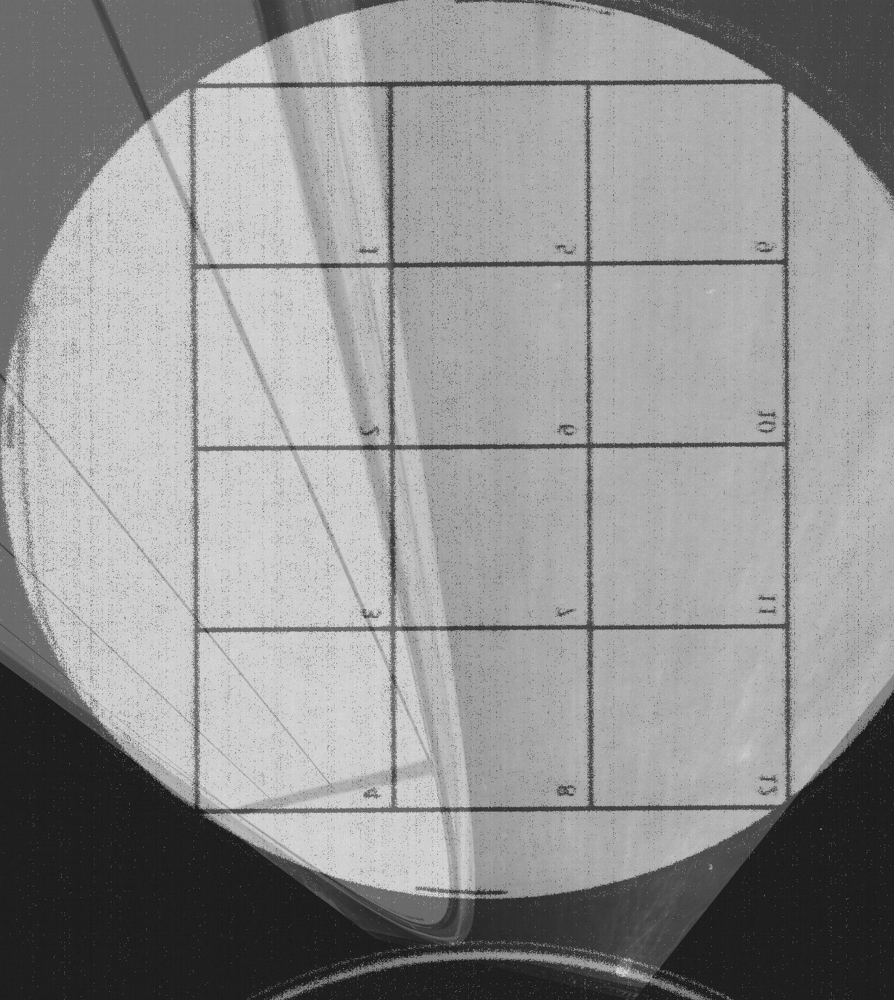

(alignment) 

: 1

In [4]:
cd ~/code/ImageAlignment
python main.py \
--hyper-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.csv' \
--rgb-img '/home/labgroup/Downloads/FAC_images_only_nonstandardized/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg' \
--mode 1 \
--image_thresh_high=120 \
--image_thresh_low=50 \
--distance=0.6 \
--gaussian_sigma 0.7
display < output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_aligned.jpg

## Run grid search to find best parameter for `gaussian_sigma`

In [2]:
cd ~/code/ImageAlignment

In [3]:
conda activate alignment

(alignment) 

: 1

0.5
------------Preprocess is saved and finished.-------------------
Homography : 
 [[ 4.18956119e-01 -2.61578483e-01  4.04259524e+02]
 [-7.16222558e-02  2.69466615e-01  2.77523317e+02]
 [-2.88133206e-04 -1.19686529e-04  1.00000000e+00]]

Saving aligned image and homography matrix at:
output/chromagrid_I5.0_F1.9_L100_144338_0_0_0_rgb


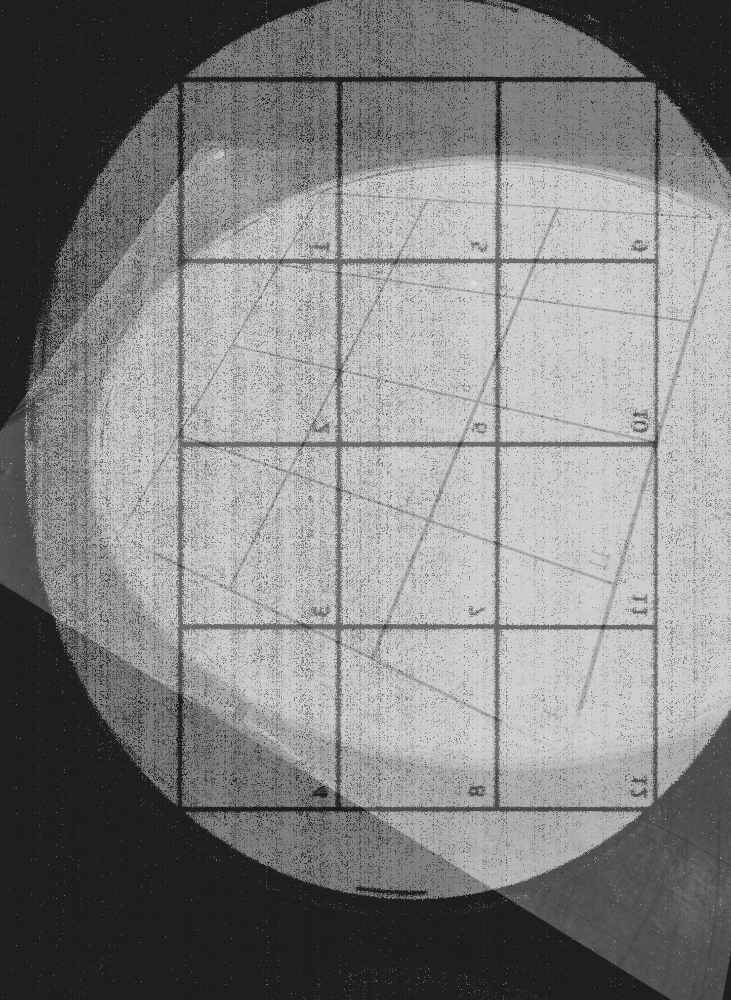


0.6
------------Preprocess is saved and finished.-------------------
Homography : 
 [[-3.52686631e+00 -3.60299069e-01  2.47773398e+03]
 [-1.88646160e+00 -1.17736303e+00  1.97720989e+03]
 [-2.23858549e-03  1.17532320e-05  1.00000000e+00]]

Saving aligned image and homography matrix at:
output/chromagrid_I5.0_F1.9_L100_144338_0_0_0_rgb


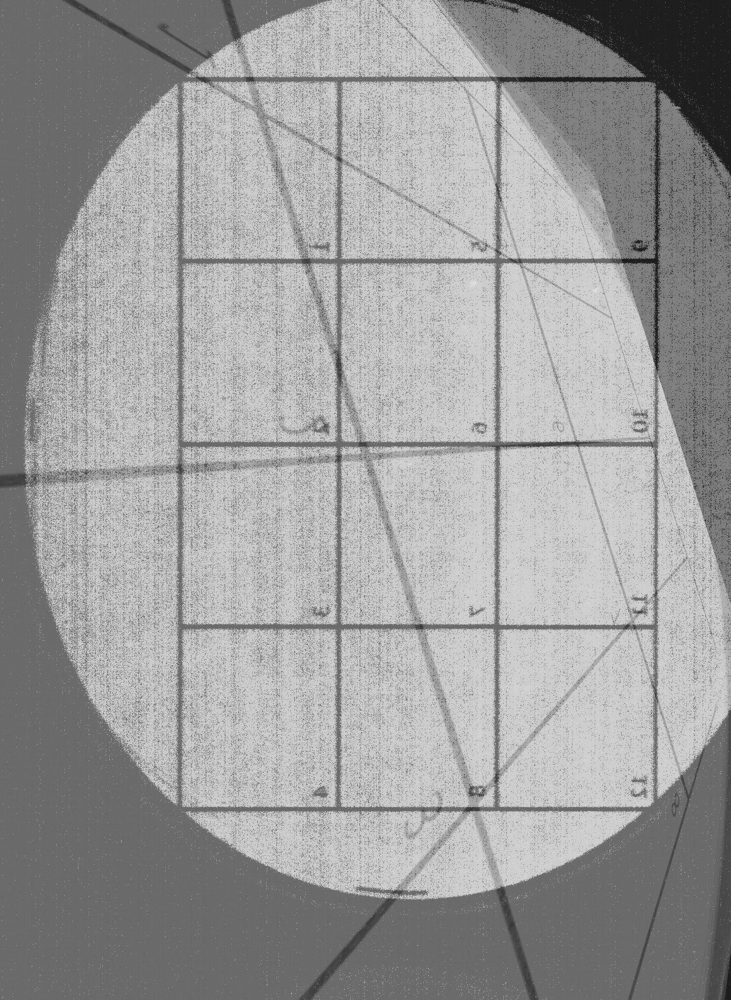


0.7
------------Preprocess is saved and finished.-------------------
Homography : 
 [[ 1.18816859e+00  7.89918407e-04 -1.95424873e+02]
 [-5.33044939e-03  1.01620110e+00 -1.17440776e+02]
 [ 1.36731064e-06  1.94873412e-06  1.00000000e+00]]

Saving aligned image and homography matrix at:
output/chromagrid_I5.0_F1.9_L100_144338_0_0_0_rgb


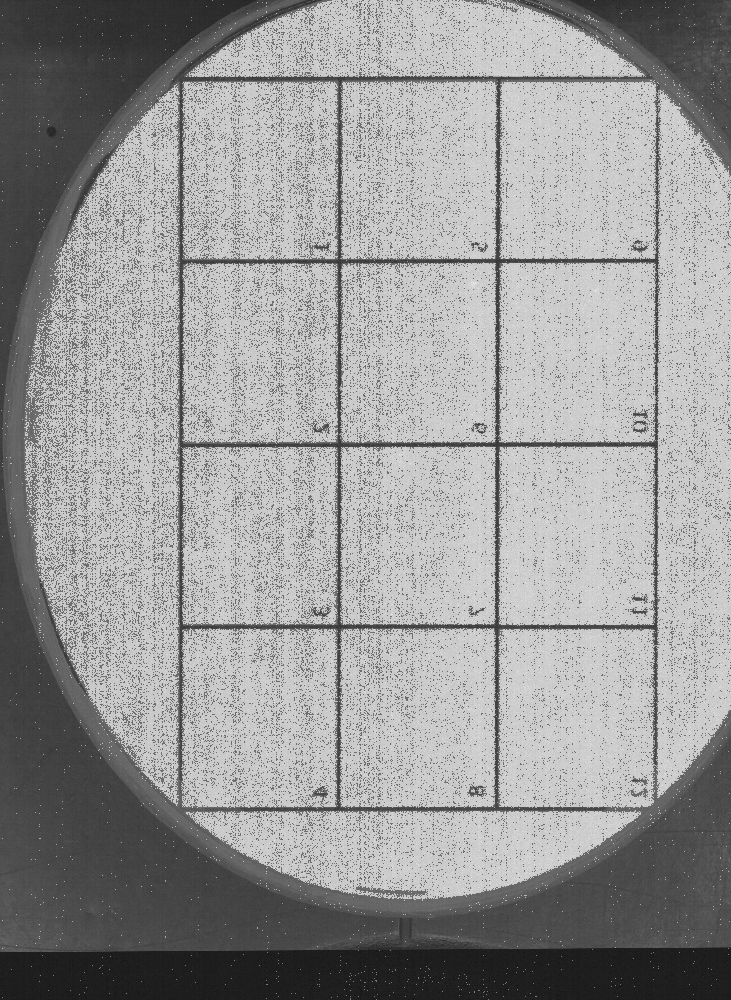


0.8
------------Preprocess is saved and finished.-------------------
Homography : 
 [[-3.63823776e+00 -2.19288105e+00  3.00857516e+03]
 [-4.52002451e+00 -7.29432359e-01  2.41668524e+03]
 [-2.88480699e-03 -6.72456804e-04  1.00000000e+00]]

Saving aligned image and homography matrix at:
output/chromagrid_I5.0_F1.9_L100_144338_0_0_0_rgb


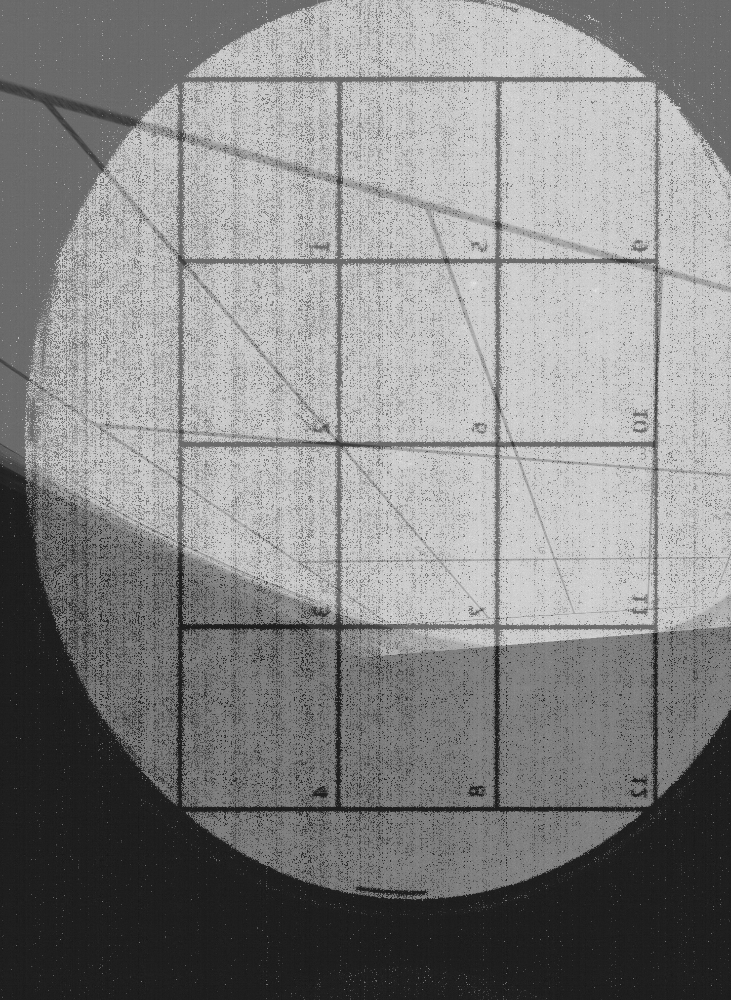


0.9
------------Preprocess is saved and finished.-------------------
Homography : 
 [[-2.20247492e+00 -9.95872129e-01  1.32877533e+03]
 [-2.78450804e+00 -4.50265092e-01  1.47646042e+03]
 [-1.76957932e-03 -7.24545510e-04  1.00000000e+00]]

Saving aligned image and homography matrix at:
output/chromagrid_I5.0_F1.9_L100_144338_0_0_0_rgb


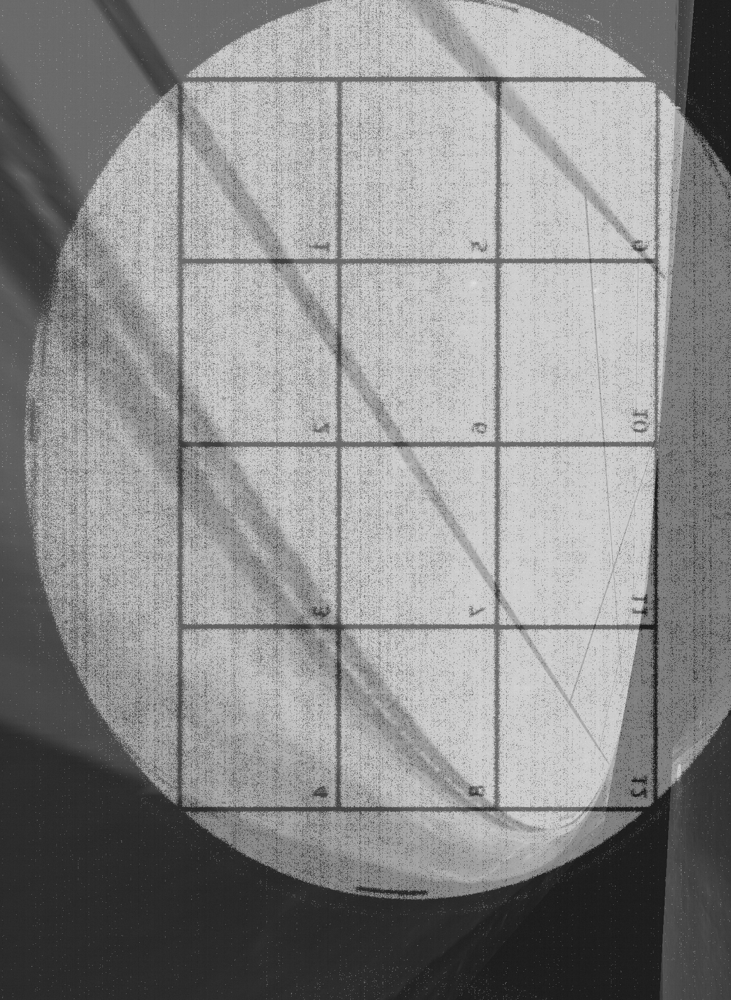


1.0
------------Preprocess is saved and finished.-------------------


In [ ]:
for i in $(seq 0.5 0.1 1.5)
  do echo $i
  rm output/chromagrid_I5.0_F1.9_L100_144338*
  python main.py \
  --hyper-img '/run/media/labgroup/Elements_9/Transformation/FAA_Dev_Genes/wk10/Fluorescence/hypercube_to_csv.csv' \
  --rgb-img '/run/media/labgroup/Elements_9/Transformation/FAA_Dev_Genes/wk10/Fluorescence/chromagrid_I5.0_F1.9_L100_144338_0_0_0_rgb.jpg' \
  --mode 1 \
  --image_thresh_high=120 \
  --image_thresh_low=50 \
  --distance=0.6 \
  --gaussian_sigma $i
  display < output/chromagrid_I5.0_F1.9_L100_144338_0_0_0_rgb_aligned.jpg
  echo ""
  done

<div class="alert alert-block alert-success"> Conclusion: Running over values of `gaussian_sigma`, 0.74 or 0.76 works best for image taken at 122503. Does the same parameter work for our other test image?  </div>


## Test optimized parameters with our other test image.

------------Preprocess is saved and finished.-------------------
Homography : 
 [[ 1.58742693e+00  5.70183581e-01 -4.52465371e+02]
 [ 1.58567242e-02  1.92825436e+00 -2.83710885e+02]
 [ 1.20877623e-04  6.67271838e-04  1.00000000e+00]]

Saving aligned image at:
output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb
(alignment) 

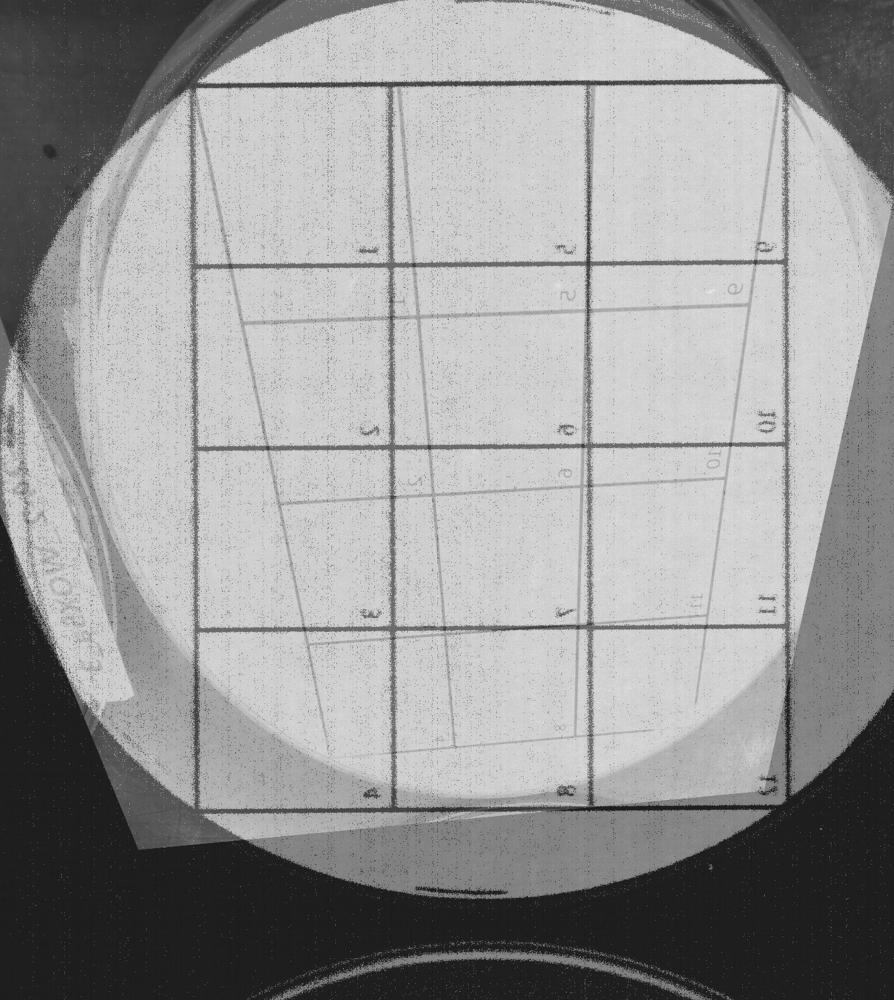

(alignment) 

: 1

In [11]:
python main.py \
--hyper-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.csv' \
--rgb-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg' \
--mode 1 \
--image_thresh_high=120 \
--image_thresh_low=50 \
--distance=0.7 \
--gaussian_sigma 0.76
display < output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_aligned.jpg

<div class="alert alert-block alert-danger"> Same parameters are not working... Let's iterate again and look for parameters that work.  </div>


In [8]:
# for i in $(seq 0.4 0.01 0.6)
#   do echo $i
#   rm output/chromagrid_I5.0_F1.9_L100_131132*
#   python main.py \
#   --hyper-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.csv' \
#   --rgb-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg' \
#   --mode 1 \
#   --image_thresh_high=120 \
#   --image_thresh_low=50 \
#   --distance=0.6 \
#   --gaussian_sigma $i
#   display < output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_aligned.jpg
#   done

(alignment) (alignment) (alignment) (alignment) (alignment) (alignment) (alignment) (alignment) (alignment) (alignment) (alignment) (alignment) (alignment) 

: 1

<div class="alert alert-block alert-success"> `gaussian_sigma` of 0.57 works for image taken at 131132. Does it work for the other image?  </div>


## Retry first image with parameter after more fine-tuning with other image

### Try version of image that was uploaded to Box

------------Preprocess is saved and finished.-------------------
Homography : 
 [[ 1.21844949e+00  1.84594090e-03 -2.27948326e+02]
 [-5.31928862e-03  9.97114650e-01 -9.22213795e+01]
 [ 1.43267480e-06  3.90899712e-06  1.00000000e+00]]

Saving aligned image at:
output/chromagrid_I5.0_F1.9_L100_122503_0_0_0_rgb
(alignment) 

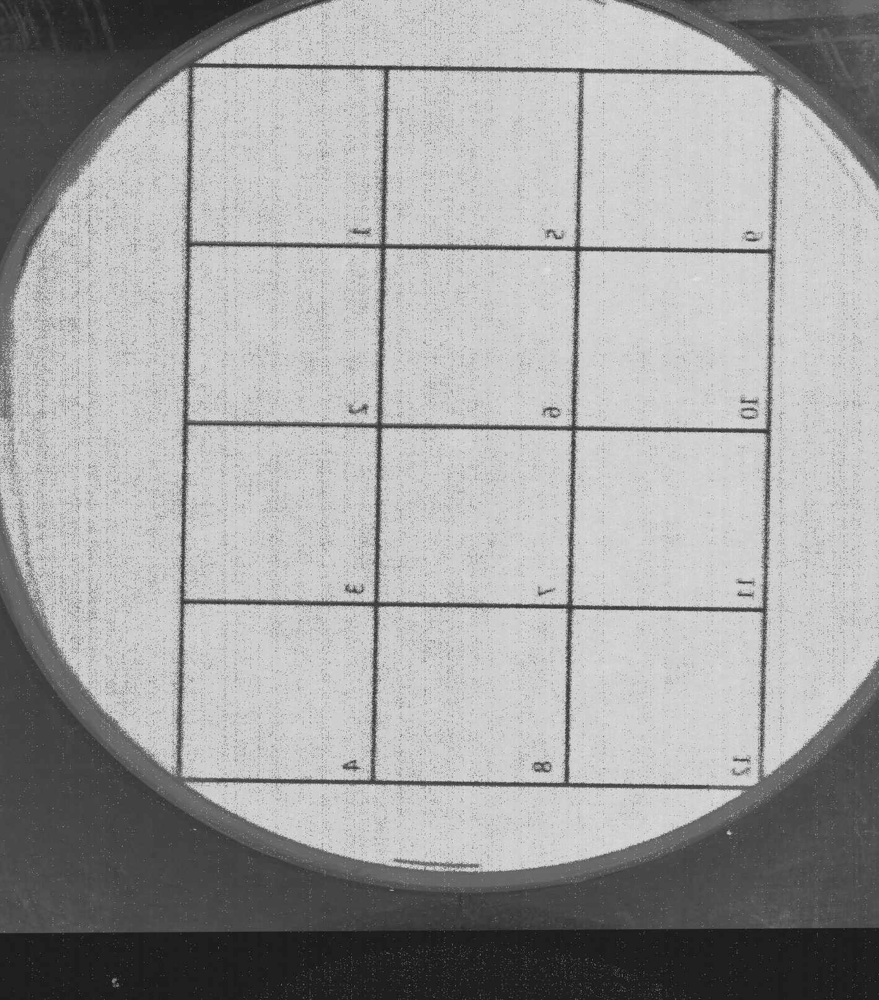

(alignment) 

: 1

In [3]:
python main.py \
--hyper-img '/home/labgroup/Downloads/inputa2/chromagrid_I5.0_F1.9_L100_122503_0_0_0_rgb.csv' \
--rgb-img '/home/labgroup/Downloads/inputa2/chromagrid_I5.0_F1.9_L100_122503_0_0_0_rgb.jpg' \
--mode 1 \
--image_thresh_high=120 \
--image_thresh_low=50 \
--distance=0.6 \
--gaussian_sigma 0.57
display < output/chromagrid_I5.0_F1.9_L100_122503_0_0_0_rgb_aligned.jpg

<div class="alert alert-block alert-success"> Great! Let's doublecheck that it works with the second image. </div>


In [17]:
pwd

/home/labgroup/code/test/ImageAlignment
(alignment) 

: 1

------------Preprocess is saved and finished.-------------------
Homography : 
 [[ 1.17885944e+00 -2.94584106e-03 -2.09299877e+02]
 [-8.72060163e-03  9.78380660e-01 -8.02148391e+01]
 [-1.12613328e-05 -8.61608656e-06  1.00000000e+00]]

Saving aligned image at:
output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb
(alignment) 

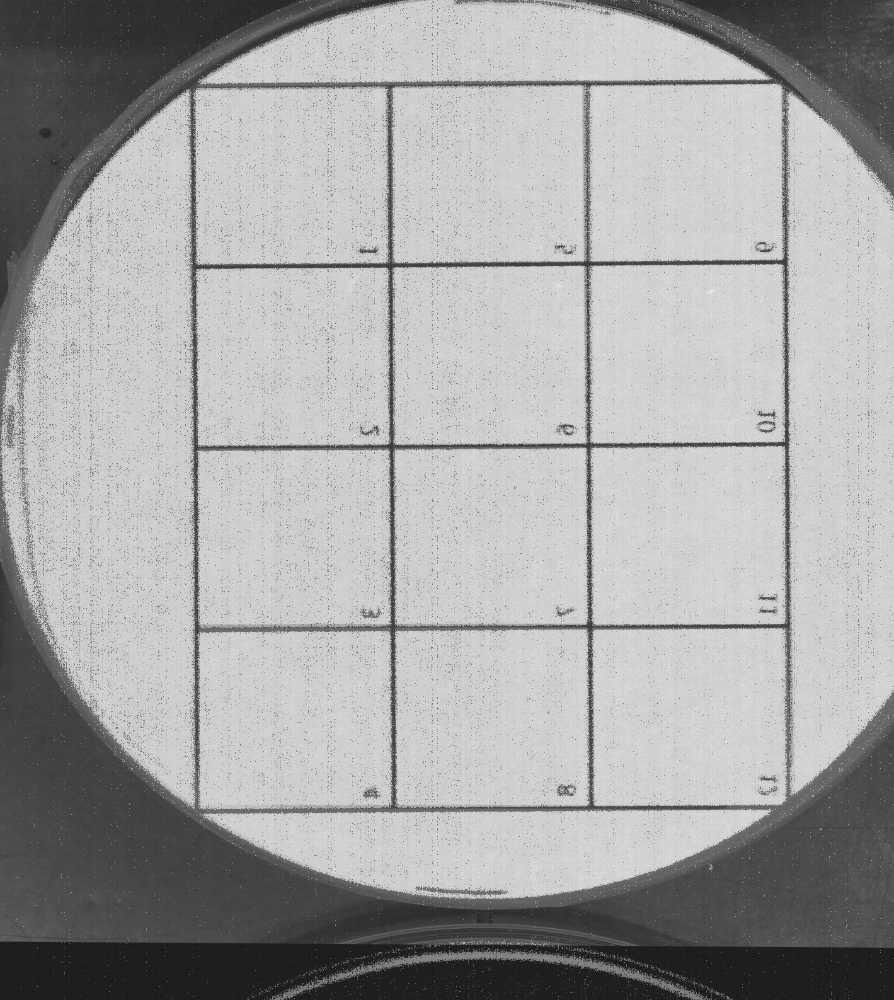

(alignment) 

: 1

In [22]:
python main.py \
--hyper-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.csv' \
--rgb-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg' \
--mode 1 \
--image_thresh_high=120 \
--image_thresh_low=50 \
--distance=0.6 \
--gaussian_sigma 0.57
display < output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_aligned.jpg

### Try with version of first image that is still on data hard drive

In [10]:
ls 

chromagrid_I5.0_F1.9_L100_131132_0_0_0.hdr
chromagrid_I5.0_F1.9_L100_131132_0_0_0.raw
chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_cropped.jpg
chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.csv
chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg
FAC1_I5.0_F1.9_L100_140329_0_0_0.hdr
FAC1_I5.0_F1.9_L100_140329_0_0_0.raw
FAC1_I5.0_F1.9_L100_140329_0_0_0_rgb_cropped.jpg
FAC1_I5.0_F1.9_L100_140329_0_0_0_rgb.jpg
FAC1_I5.0_F1.9_L100_140329_0_0_0_segment_cropped.png
FAC1_I5.0_F1.9_L100_140329_0_0_0_segment_uncropped.png
FAC1_I5.0_F1.9_L100_140411_1_0_1_blend.png
FAC1_I5.0_F1.9_L100_140411_1_0_1_composite.png
FAC1_I5.0_F1.9_L100_140411_1_0_1.hdr
FAC1_I5.0_F1.9_L100_140411_1_0_1.raw
FAC1_I5.0_F1.9_L100_140411_1_0_1_rgb_cropped.jpg
FAC1_I5.0_F1.9_L100_140411_1_0_1_rgb.jpg
FAC1_I5.0_F1.9_L100_140411_1_0_1_segment_cropped.png
FAC1_I5.0_F1.9_L100_140411_1_0_1_segment_uncropped.png
FAC1_I5.0_F1.9_L100_140506_2_0_2_blend.png
FAC1_I5.0_F1.9_L100_140506_2_0_2_composite.png
FAC1_I5.0_F1.9_L100_140506_2_0_2.hdr
FAC1

: 1

------------Preprocess is saved and finished.-------------------
Homography : 
 [[-1.29222354e+02  7.70376856e+02  1.10248588e+04]
 [-2.84701781e+01  6.79241549e+02  2.37455163e+03]
 [-2.55572809e-02  5.48998386e-01  1.00000000e+00]]

Saving aligned image at:
output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb
(alignment) 

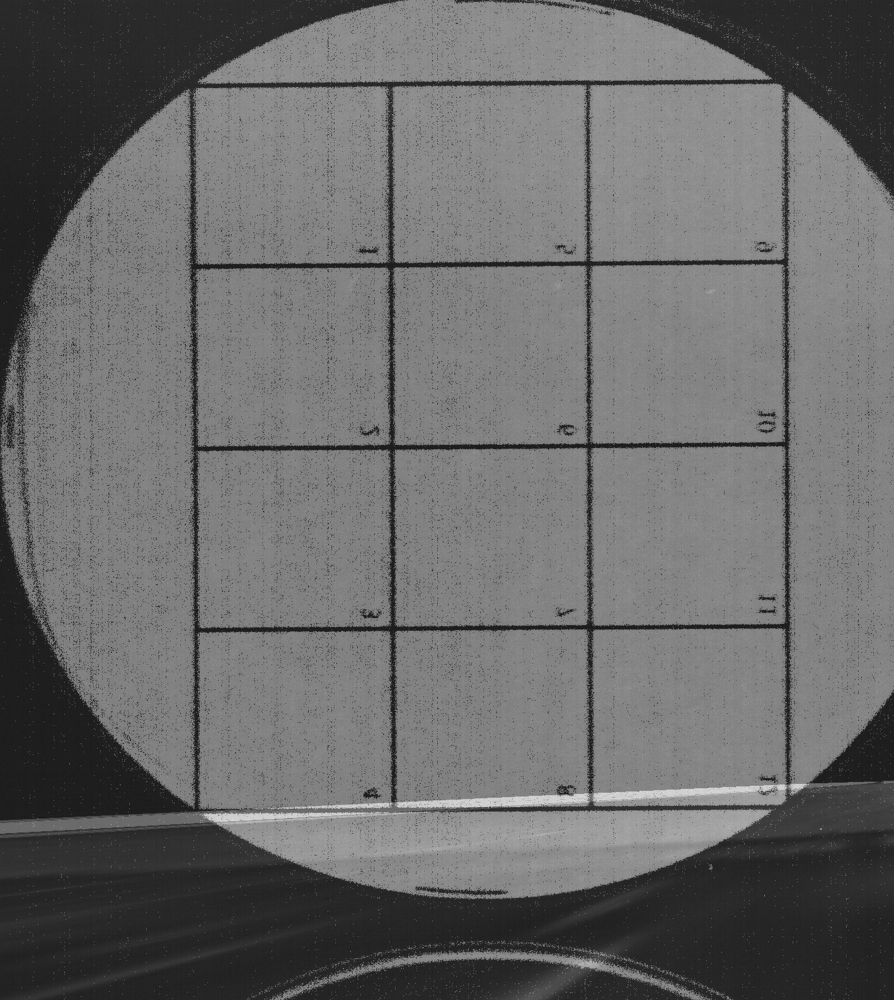

(alignment) 

: 1

In [21]:
python main.py \
--hyper-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.csv' \
--rgb-img '/run/media/labgroup/Elements_7/Transformation/FAC_Dev_Genes/wk3/Fluorescence/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg' \
--mode 1 \
--image_thresh_high=120 \
--image_thresh_low=50 \
--distance=0.6 \
--gaussian_sigma 0.57
display < output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_aligned.jpg

<div class="alert alert-block alert-danger"> Why are we getting a different result for two versions of the SAME image? </div>


In [28]:
identify -verbose /run/media/labgroup/Elements_7/Transformation/FAC_Dev_Genes/wk3/Fluorescence/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg | grep Orientation

  Orientation: Undefined
(alignment) 

: 1

In [29]:
identify -verbose /home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg | grep Orientation

  Orientation: TopLeft
(alignment) 

: 1

#### Try to change image orientation from `Undefined` to `TopLeft` and see if it works

In [31]:
which exiftool

~/anaconda3/envs/alignment/bin/exiftool
(alignment) 

: 1

In [32]:
exiftool -Orientation=1 -n /run/media/labgroup/Elements_7/Transformation/FAC_Dev_Genes/wk3/Fluorescence/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg

    1 image files updated
(alignment) 

: 1

Did it work?

In [36]:
identify -verbose /run/media/labgroup/Elements_7/Transformation/FAC_Dev_Genes/wk3/Fluorescence/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg | grep Orientation

  Orientation: TopLeft
(alignment) 

: 1

Yes. Now let's see if it fixes the problem....

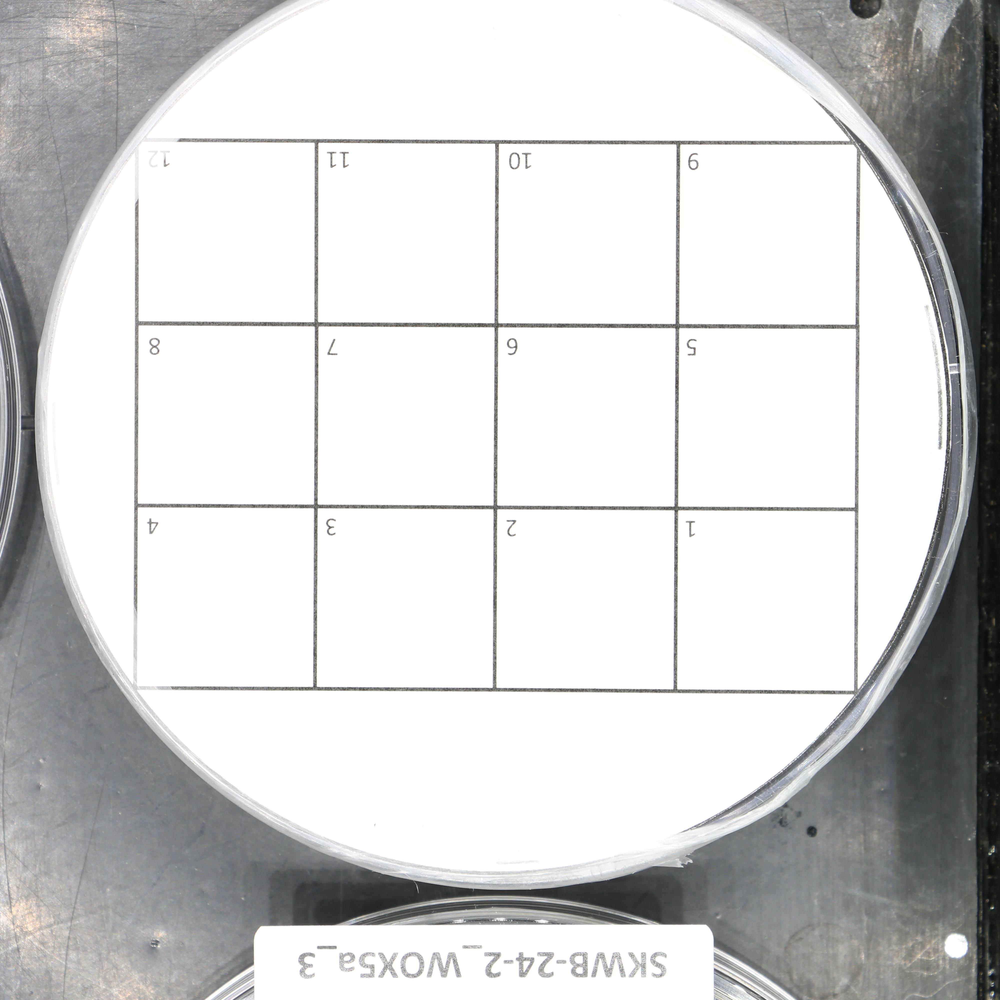

(alignment) 

: 1

In [35]:
display < '/run/media/labgroup/Elements_7/Transformation/FAC_Dev_Genes/wk3/Fluorescence/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg'

In [ ]:
echo $aligned

In [ ]:
python main.py \
--hyper-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.csv' \
--rgb-img '/run/media/labgroup/Elements_7/Transformation/FAC_Dev_Genes/wk3/Fluorescence/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg' \
--mode 1 \
--image_thresh_high=120 \
--image_thresh_low=50 \
--distance=0.6 \
--gaussian_sigma 0.57
display < output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_aligned.jpg

<div class="alert alert-block alert-danger"> Still having the same problem... Is there any other difference in metadata between these two images?  </div>


In [42]:
# identify -verbose /run/media/labgroup/Elements_7/Transformation/FAC_Dev_Genes/wk3/Fluorescence/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg

(alignment) 

: 1

In [43]:
# identify -verbose /home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg

(alignment) 

: 1

<div class="alert alert-block alert-warning"> Quality is 75 for the version in the data folder, which was processed using python `standardize_orientation.py` </div>


I edited `standardize_orientation.py` to include `quality=91` as flag for `img.save`

Now let's try running it over the image and see if it still breaks it. If not, then we can prevent this (at least for this image) by maintaining quality.

In [46]:
cd ~/code/GMOnotebook/intermediates

(alignment) 

: 1

In [48]:
conda activate base

(base) 

: 1

In [49]:
python standardize_orientation.py /home/labgroup/Downloads/input/

(base) 

: 1

In [50]:
conda activate alignment

(alignment) 

: 1

Does this image still work?

In [52]:
cd ~/code/ImageAlignment

(alignment) 

: 1

------------Preprocess is saved and finished.-------------------
Homography : 
 [[ 1.20635568e+00 -1.02014092e-02 -2.19052222e+02]
 [-3.09265334e-03  9.83411651e-01 -8.29378039e+01]
 [ 3.42410742e-06 -1.69823453e-05  1.00000000e+00]]

Saving aligned image at:
output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb
(alignment) 

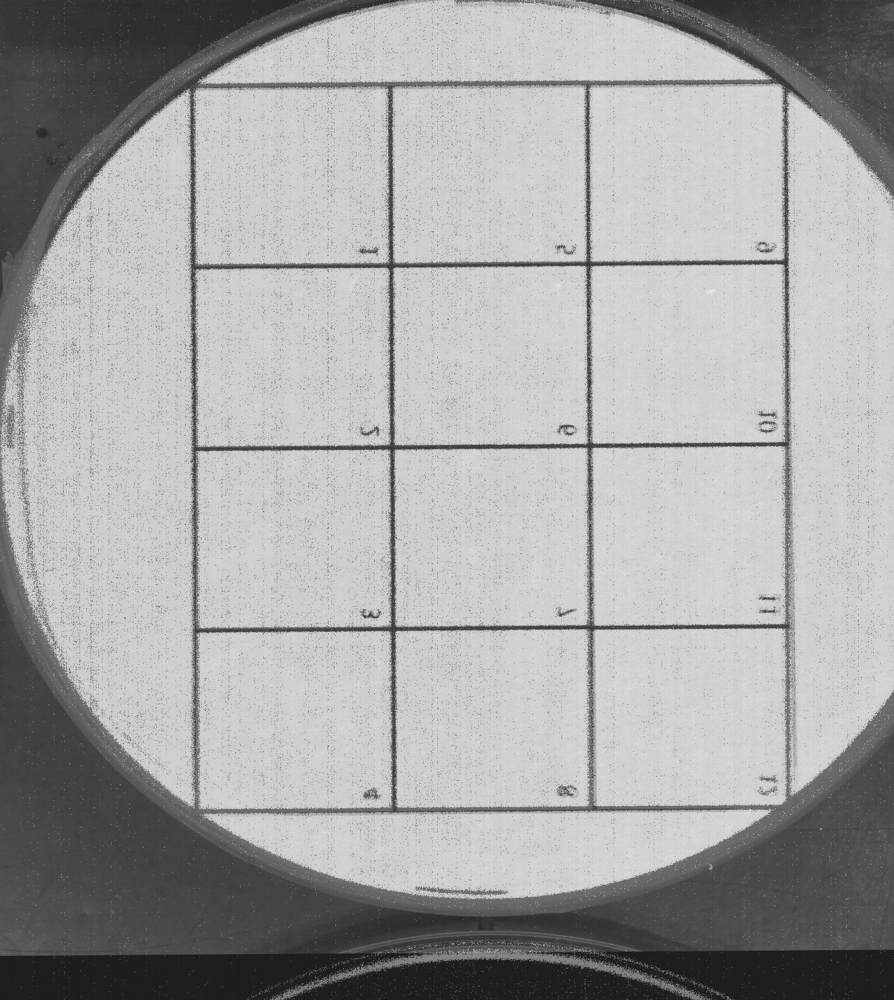

(alignment) 

: 1

In [53]:
python main.py \
--hyper-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.csv' \
--rgb-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg' \
--mode 1 \
--image_thresh_high=120 \
--image_thresh_low=50 \
--distance=0.6 \
--gaussian_sigma 0.57
display < output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_aligned.jpg

<div class="alert alert-block alert-success"> Success.  </div>


## Does it also work with our old image?

In [ ]:
python main.py \
--hyper-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.csv' \
--rgb-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg' \
--mode 1 \
--image_thresh_high=120 \
--image_thresh_low=50 \
--distance=0.6 \
--gaussian_sigma 0.57
display < output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_aligned.jpg

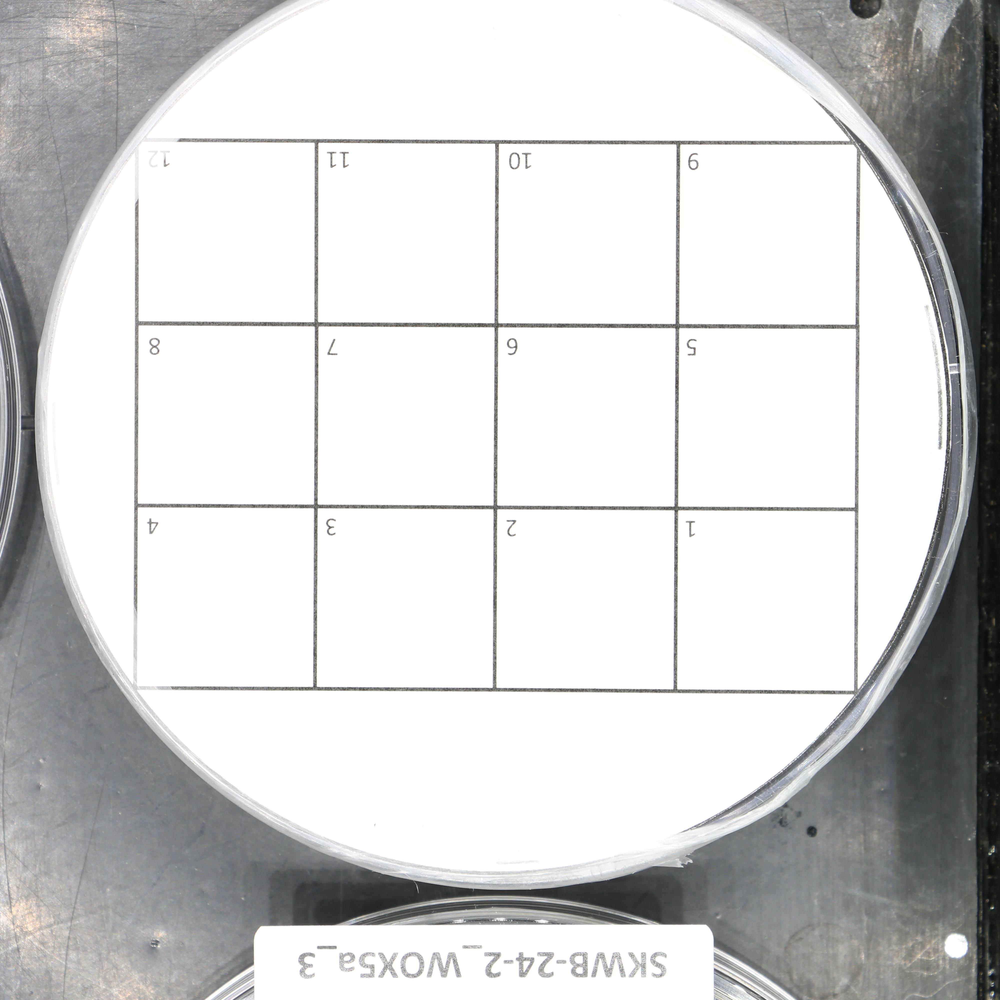

(alignment) 

: 1

In [37]:
display < /run/media/labgroup/Elements_7/Transformation/FAC_Dev_Genes/wk3/Fluorescence/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg

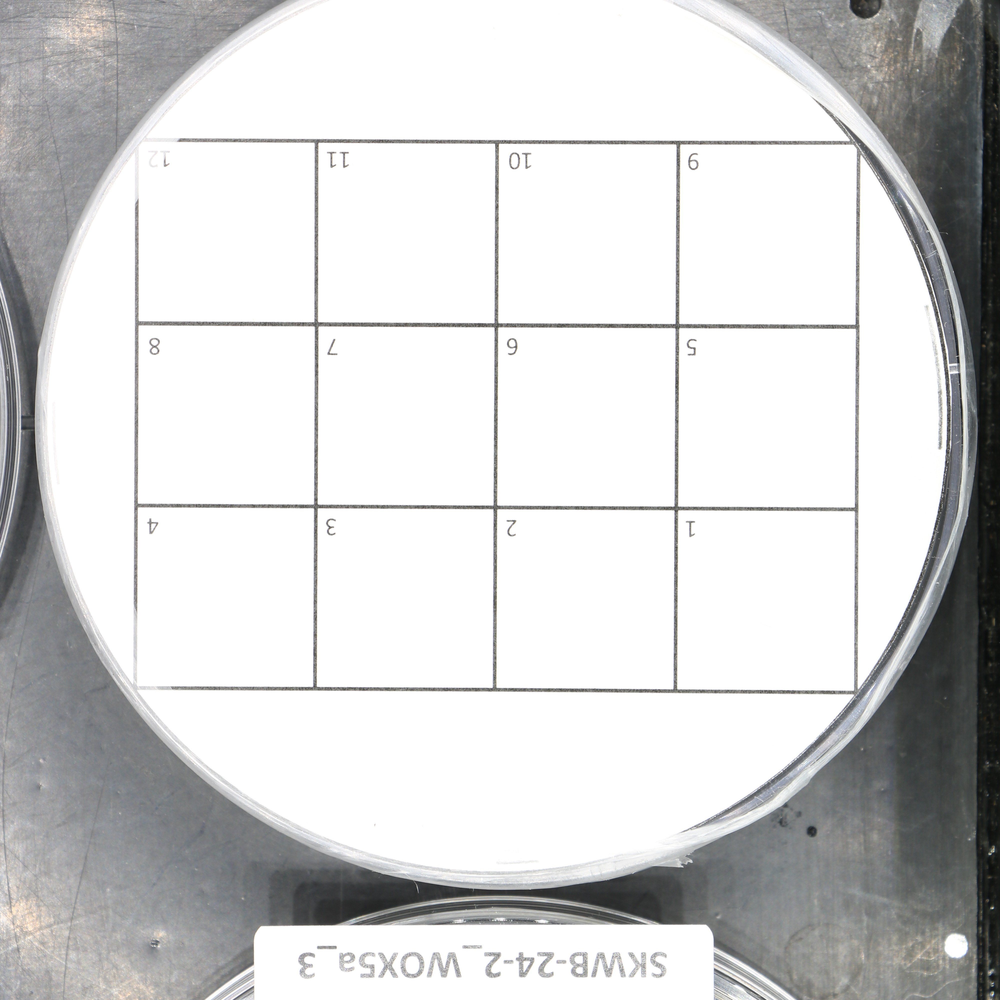

(alignment) 

: 1

In [38]:
display < /home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg

In [18]:
rm output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_aligned.jpg

(alignment) 

: 1

In [16]:
ls /home/labgroup/Downloads/inputa2/

chromagrid_I5.0_F1.9_L100_122503_0_0_0_rgb.csv
chromagrid_I5.0_F1.9_L100_122503_0_0_0_rgb.jpg
(alignment) 

: 1

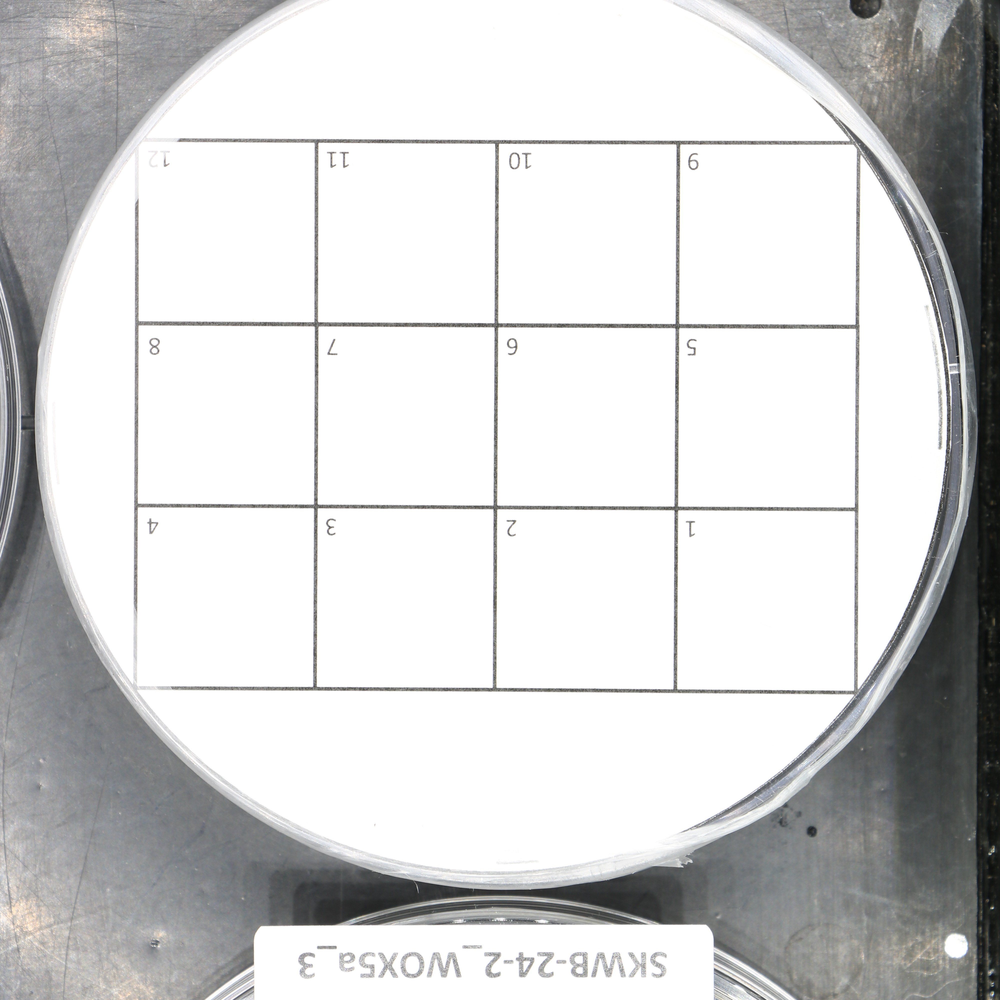

(alignment) 

: 1

In [20]:
display < /home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg

------------Preprocess is saved and finished.-------------------
Homography : 
 [[ 1.17885944e+00 -2.94584106e-03 -2.09299877e+02]
 [-8.72060163e-03  9.78380660e-01 -8.02148391e+01]
 [-1.12613328e-05 -8.61608656e-06  1.00000000e+00]]

Saving aligned image at:
output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb
(alignment) 

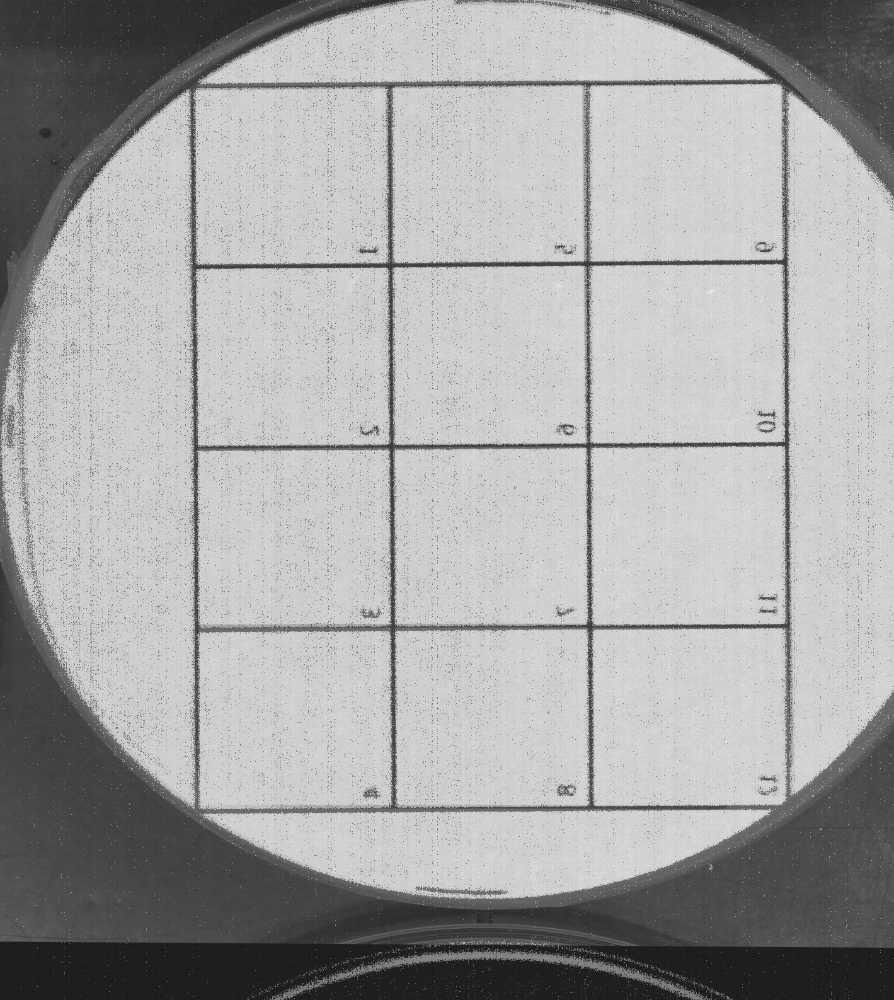

(alignment) 

: 1

In [19]:
python main.py \
--hyper-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.csv' \
--rgb-img '/home/labgroup/Downloads/input/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb.jpg' \
--mode 1 \
--image_thresh_high=120 \
--image_thresh_low=50 \
--distance=0.6 \
--gaussian_sigma 0.57
display < output/chromagrid_I5.0_F1.9_L100_131132_0_0_0_rgb_aligned.jpg

In [ ]:
for i in $(seq 0 0.05 1)
  do echo $i
  rm output/chromagrid_I5.0_F1.9_L100_122503*
  python main.py \
  --hyper-img '/home/labgroup/Downloads/inputa2/chromagrid_I5.0_F1.9_L100_122503_0_0_0_rgb.csv' \
  --rgb-img '/home/labgroup/Downloads/inputa2/chromagrid_I5.0_F1.9_L100_122503_0_0_0_rgb.jpg' \
  --mode 1 \
  --image_thresh_high=120 \
  --image_thresh_low=50 \
  --distance=0.6 \
  --gaussian_sigma 0.45
  display < output/chromagrid_I5.0_F1.9_L100_122503_0_0_0_rgb_aligned.jpg
  done

0.00
------------Preprocess is saved and finished.-------------------


In [49]:
for i in $(seq 1 $END); do echo $i; done

1/5
2/5
3/5
4/5
5/5
(alignment) 

: 1